# PHYS6318: Lecture 6

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
from matplotlib import rcParams
rcParams['animation.html'] = 'jshtml'
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import numpy as np
import xarray as xr
import netCDF4
import time
import os
import glob

## OMB 5.4 The Wind-Forced Shallow-Water Model

### 5.4.1 The Governing Equations

The global ocean circulation is primarily driven by the wind.  To model this we add in wind-stress forcing along the surface as well as bottom friction:

$$\begin{align}
\frac{\partial u}{\partial t} &= -g \frac{\partial \eta}{\partial x} + \frac{\tau_x^{\mbox{wind}} - \tau_x^{\mbox{bot}}}{\rho_0 h} \\
\frac{\partial v}{\partial t} &= -g \frac{\partial \eta}{\partial y} + \frac{\tau_y^{\mbox{wind}} - \tau_y^{\mbox{bot}}}{\rho_0 h} \\
\frac{\partial \eta}{\partial t} &= -\frac{( u h )}{\partial x}  - \frac{( u h )}{\partial y} 
\end{align}$$

Here $( \tau_x^{\mbox{wind}}, \tau_y^{\mbox{wind}} ) $ is the wind-stress vector, and $( \tau_x^{\mbox{bot}}, \tau_y^{\mbox{bot}} ) $ is the bottom-stress vector. For the time being, we are neglecting lateral friction, non-linear terms, and the Coriolis force.  The model describes the depeth averaged effects of wind forcing and bottom friction.


### 5.4.2 Semi-implicit Approach for Bottom Friction

To include friction along the bottom we have to determine some way of parameterize that friction.

For motivation, consider the slightly abstract problem of a "block" of water of height $h$ sliding along the ground with some initial speed $u_0$ (we treat the block as being rigid in this abtract problem).  

![](https://s3-us-west-2.amazonaws.com/courses-images/wp-content/uploads/sites/2952/2018/01/31190941/CNX_UPhysics_06_02_Friction.jpg)

Newton's law says

$$ m \frac{d u}{dt} = \vec{f} = - \tau_x^{\mbox{bot}}A $$

where $m$ is the mass of this block of water.  In terms of density, $m = \rho_0 A h$ where $A$ is the bottom area of the block. The surface stress $\tau_x$ is a applied over the entire surface area $A$.

So, we can expand out mass

$$  \rho_0 h A \frac{d u}{dt} = - \tau_x^{\mbox{bot}}A $$

to get

$$  \frac{d u}{dt} =  \frac{- \tau_x^{\mbox{bot}}}{\rho_0 h} $$

The bottom stress $\tau_x^{\mbox{bot}}$ can be parametrized as being proportional to the surface area, the density of the water, and a term that depends on the square of the velocity:

$$ - \tau_x^{\mbox{bot}} = - r \rho_0  u | u|$$

where $r$ is a non-dimensional bottom drag-coefficient. The use of the absolute value signs ensures that the drag force is always opposing the direction of motion. While similar, this not the same as the modelling of kinetic friction which depends on the normal force between the block at the surface; since our "block" is made of water we focus on the relative velocity between the water and the surface instead.

Given this parametrization of friction, Newton's Law becomes

$$ \frac{d u}{dt}  = - r \frac{\rho_0 u | u|}{\rho_0 h } = - r \frac{u | u |}{ h}$$

If we tried an explicit numerical scheme

$$\begin{align}
\frac{u^{n+1} - u^n}{\Delta t} &= -r  \frac{u^n | u^n |}{ h} \\
\\
\implies u^{n+1} &= u^n -r  \Delta t \frac{ u^n | u^n | }{ h}  \\
 u^{n+1} &= u^n \left( 1  -r  \Delta t \frac{| u^n |}{ h} \right)  \\
 u^{n+1} &= u^n \left( 1  - \epsilon \right) 
\end{align}
$$

with $\epsilon =  r  \Delta t \frac{| u^n |}{ h}$.  

A problem occurs when we let the height $h$ of the "block" change with its position. Since our block is made of water as it moves to a shallower depth, it depths shorter and spreads out. But, ff $h$ becomes small, then we can have $\epsilon > 1$ which would lead to an acceleration of the block.  Clearly, friction forces cannot do that.

Instead, we use a semi-implicit scheme

$$  u^{n+1} = u^n  -r  \Delta t u^{n+1} \frac{| u^n |}{h}  $$

to avoid this problem. Reorganizing this equation gives

$$ u^{n+1} = \frac{u^n} { 1 + r \Delta t \frac{ |u^n|}{ h}  } = \frac{u^n} { 1 + R} $$

where $R = r \Delta t |u^n|/ h $.  This parameter $R$ is always a positive quantity so that bottom friction will gradually decrease speed as required.   

The above derivation is actually just the same as shallow water fluid acting *only* under the influence of bottom friction:

$$\begin{align}
\frac{\partial u}{\partial t} &= - r u \frac{ \sqrt{(u^2 + v^2)} }{ h} \\
\frac{\partial v}{\partial t} &= - r v \frac{\sqrt{(u^2 + v^2)}}{ h }\\
\end{align}$$

Notice that here $\sqrt{u^2 + v^2}$ is equivalent to $|u|$ in the one-dimension simplified problem. 

Using a semi-implicit scheme to numerically solve these equations we have

$$\begin{align}
u_{j, k}^{n+1} &= u_{j, k}^n  -r  \Delta t u_{j,k}^{n+1} \frac{ \sqrt{ \left(u_{j,k}^n\right)^2 + \left(v_u^n\right)^2 }}{h_u}  \\
v_{j, k}^{n+1} &= v_{j, k}^n  -r  \Delta t v_{j,k}^{n+1} \frac{ \sqrt{ \left(u_{v}^n\right)^2 + \left(v_{j, k}^n\right)^2 }}{h_v}  
\end{align}$$

where the subscripts $u$ and $v$ indicate the location at which a variable is calculated. This is necessary because $u$, $v$, and $h$ are not evaluated at the same grid point in the Arakawa C-grid. As before, these equations can be reorganized as

$$\begin{align}
u_{j, k}^{n+1} &= \frac{u_{j, k}^n}{1 + R_x} \\
v_{j, k}^{n+1} &= \frac{v_{j, k}^n}{1 + R_y} 
\end{align}$$

where the paramters $R_x$ and $R_y$ are

$$\begin{align}
R_x &= r  \Delta t \frac{ \sqrt{ \left(u_{j,k}^n\right)^2 + \left(v_u^n\right)^2 }}{h_u}  \\
R_y &= r  \Delta t \frac{ \sqrt{ \left(u_{v}^n\right)^2 + \left(v_{j, k}^n\right)^2 }}{h_v}  
\end{align}$$


### 5.4.3 Finite-Difference Equations

The full momentum equations want to solve are

$$\begin{align}
\frac{\partial u}{\partial t} &= -g \frac{\partial \eta}{\partial x} + \frac{\tau_x^{\mbox{wind}}}{\rho_0 h} - \frac{\tau_x^{\mbox{bot}}}{\rho_0 h} \\
\frac{\partial v}{\partial t} &= -g \frac{\partial \eta}{\partial y} + \frac{\tau_y^{\mbox{wind}}}{\rho_0 h} - \frac{\tau_y^{\mbox{bot}}}{\rho_0 h} 
\end{align}$$

We have already seen how to discritize the bottom-friction terms $\left( \frac{-\tau_x^{\mbox{bot}} }{\rho h}, \frac{-\tau_y^{\mbox{bot}} }{\rho h} \right)$. We will discritize the other forcing terms as explicit terms:

$$\begin{align}
\Delta u_{j,k}^n &= \Delta t \left\{ -g\frac{\eta_{j,k+1}^n - \eta_{j, k}^n}{\Delta x}  + \frac{\tau_x^\mbox{wind}}{\rho_0 h_u} \right\} \\
\Delta v_{j,k}^n &= \Delta t \left\{ -g\frac{\eta_{j+1,k}^n - \eta_{j, k}^n}{\Delta y}  + \frac{\tau_y^\mbox{wind}}{\rho_0 h_v} \right\}
\end{align}$$

Therefor, the momemtum equations are fully discritized as

$$\begin{align}
u_{j,k}^{n+1} &= \frac{u_{j,k} + \Delta u_{j,k}^n}{1 + R_x} \\
v_{j,k}^{n+1} &= \frac{v_{j,k} + \Delta v_{j,k}^n}{1 + R_y} \\
\end{align}$$

## OMB 5.5 Exercise 10: Wind-Driven Flow in a Lake

### 5.5.1 Aim

The aim of this exercise is to simulate the wind-driven water circulation in a shallow
lake with variable bottom topography.

### 5.5.2 Creation of Variable Bathymetry

To create an "interesting" bottom trajectory without having to specify complicated bottom topography, the textbook author starts with a coarse block-type bathemetry and then smooths it with a diffusion equation:

$$\frac{\partial h}{\partial t} = A_h \left( \frac{\partial^2 h}{\partial x^2} +  \frac{\partial^2 h}{\partial y^2} \right) $$

We can maintain coastlines and land by application of a zero-gradient condition at the borders between dry and wet grid cells. See text and numerical code for details.

Example: OMB Figure 5.7

### 5.5.3 Sample Code

As before, I've taken the original "Exercise 10" and modified it to be `src/OMB_Ex10` to include NetCDF file as output.  

Here, I've explicitly listed the h-grid, u-grid, and v-grid since they each have having slightly different coordinates.

### 5.5.4 Task Description

Consider a lake of 5 km $\times$ 5 km in horizontal extent, being resolved by equidistant horizontal grid spacings of Δx = Δy = 100 m, and variable bathymetry.
Figure 5.7 shows the lake’s bathymetry used by the author. 

Consider a uniform
southerly wind stress of $\tau_y^\mbox{wind} = 0.2$ Pa in strength being linearly adjusted from zero
to its final value over 2 days to avoid unwanted inertial and gravity waves. 

Simulate the steady-state circulation resulting from the wind-stress forcing applied. Five
days of simulation should be sufficient for this. 

Set the bottom-friction coefficient
to r = 0.001. 

I used a time step of Δt = 3 s, which satisfies the CFL stability
criterion.

### 5.5.5 Tricks for Long Model Simuations

Demo that we can visualize the results *while* the simluation is being run to observe the progress.

### 5.5.6 Results

In [255]:
filename = 'src/OMB_Ex10/output.nc' # CHANGE PATH AS NEEDED

In [256]:
ds = xr.open_dataset(filename)
ds

<xarray.Dataset>
Dimensions:  (time: 121, xh: 53, xu: 53, xv: 53, yh: 53, yu: 53, yv: 53)
Coordinates:
  * time     (time) datetime64[ns] 2000-01-01 2000-01-01T02:00:00 ... 2000-01-11
  * xh       (xh) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * yh       (yh) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * xu       (xu) float32 75.0 175.0 275.0 ... 5.075e+03 5.175e+03 5.275e+03
  * yu       (yu) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * xv       (xv) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * yv       (yv) float32 75.0 175.0 275.0 ... 5.075e+03 5.175e+03 5.275e+03
Data variables:
    h        (time, xh, yh) float32 ...
    eta      (time, xh, yh) float32 ...
    u        (time, xu, yu) float32 ...
    v        (time, xv, yv) float32 ...

Notice that h/eta, u, and v are are on three different grids

#### Arakawa C-grid

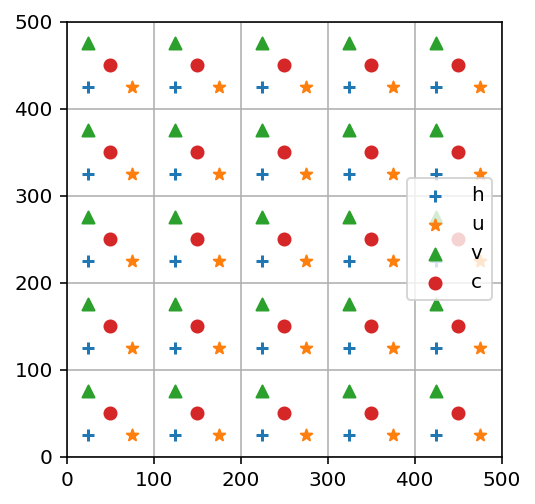

In [216]:
fig, ax = plt.subplots()
xh, yh = np.meshgrid(ds.xh, ds.yh)
ax.scatter(xh, yh, label='h', marker='+')
xu, yu = np.meshgrid(ds.xu, ds.yu)
ax.scatter(xu, yu, label='u', marker='*')
xv, yv = np.meshgrid(ds.xv, ds.yv)
ax.scatter(xv, yv, label='v', marker='^')

xc = 0.5*(xu + xv)
yc = 0.5*(yu + yv)
ax.scatter(xc, yc, label='c', marker='o')

ax.axes.grid(True)
ax.axis('square')
ax.set_xlim(0, 500)
ax.set_ylim(0, 500)
ax.legend()
plt.show()

The steady-state circulattion is established after 4 days of simluation.  We can see that in animation of the velocity field. (Strictly speaking, we should be projecting $u$ and $v$ on the same grid before making this plot)

In [257]:
def animate_velocity(filename):
    ds = xr.open_dataset(filename)
    fig, ax = plt.subplots(figsize=(8,8))

    # show time in units of days
    t = (ds.time - ds.time[0]).values / np.timedelta64(1, 'D')

    ax.contour(ds.xh/1e3, ds.yh/1e3, ds.h[0].T, colors='k', linewidths=0.5)
    
    # compute grid centres
    xu, yu = np.meshgrid(ds.xu, ds.yu)
    xv, yv = np.meshgrid(ds.xv, ds.yv)
    xc = 0.5*(xu + xv)
    yc = 0.5*(yu + yv)
    
    q = ax.quiver(xc[::3, ::3]/1e3, yc[::3, ::3]/1e3, 
               ds.u[0, ::3, ::3].T, 
               ds.v[0, ::3, ::3].T, scale=5)
    text = ax.text(4, 5.3, f'time= {t[0]:.0f} days')

    def init():
        ax.set_title('Velocity')
        ax.set_xlabel('x (km)')
        ax.set_ylabel('y (km)')
        
        return q, text
    
    def update(frame):

        q.set_UVC(ds.u[frame, ::3, ::3].T, ds.v[frame, ::3,::3].T)
        text.set_text(f'time= {t[frame]:.1f} days')
        
        return q, text
    
        
    anim = FuncAnimation(fig, update, blit=True,
                         init_func=init,
                         #frames=len(ds.time),
                         frames=np.arange(0, 121, 10),
                        )
    plt.close(fig)
    
    return anim
    
animate_velocity(filename)

Since it is very shallow near the lake's banks, there is strong effect on the velocity in those region.  For visualization, it is better to consider the integrated velocity components; that is, lateral volume transport.

In [258]:
def calc_transport(u, v, h):
    
    uh = np.zeros((53, 53))
    vh = np.zeros((53, 53))
    
    for j in range(1, 52): 
        for k in range(1, 52):
            uh[k, j] = u[k, j]*0.5*(h[k,j] + h[k+1, j])
            vh[k, j] = v[k, j]*0.5*(h[k,j] + h[k, j+1])

    return uh, vh

In [259]:
def animate_transport(filename):
    ds = xr.open_dataset(filename)
    fig, ax = plt.subplots(figsize=(8,8))

    # show time in units of days
    t = (ds.time - ds.time[0]).values / np.timedelta64(1, 'D')

    ax.contour(ds.xh/1e3, ds.yh/1e3, ds.h[0].T, colors='k', linewidths=0.5)
    
    # compute grid centres
    xu, yu = np.meshgrid(ds.xu, ds.yu)
    xv, yv = np.meshgrid(ds.xv, ds.yv)
    xc = 0.5*(xu + xv)
    yc = 0.5*(yu + yv)
    
    uh, vh = calc_transport(ds.u[0].values, ds.v[0].values, ds.h[0].values)
    
    q = ax.quiver(xc[::3, ::3]/1e3,
                  yc[::3, ::3]/1e3, 
                  uh[::3, ::3].T, 
                  vh[::3 ,::3].T, 
                  scale=70)
    text = ax.text(4, 5.3, f'time= {t[0]:.0f} days')

    def init():
        ax.set_title('Transport')
        ax.set_xlabel('x (km)')
        ax.set_ylabel('y (km)')
        
        return q, text
    
    def update(frame):

        uh, vh = calc_transport(ds.u[frame].values, ds.v[frame].values, ds.h[frame].values)
        
        q.set_UVC(uh[::3, ::3].T, vh[::3, ::3].T)
        text.set_text(f'time= {t[frame]:.1f} days')
        
        return q, text
    
        
    anim = FuncAnimation(fig, update, blit=True,
                         init_func=init,
                         #frames=len(ds.time),
                         frames=np.arange(0, 121, 10),
                        )
    plt.close(fig)
    
    return anim
    
animate_transport(filename)

### Note:

**While the above animation looks similiar in character to OMB Fig 5.8, there are small differences suggesting that this is an error in either the model code, the textbook, and/or the visualization that still need to be identified.** 

In [489]:
uF = np.loadtxt('src/OMB_Ex10/uF.dat')
vF = np.loadtxt('src/OMB_Ex10/vF.dat')

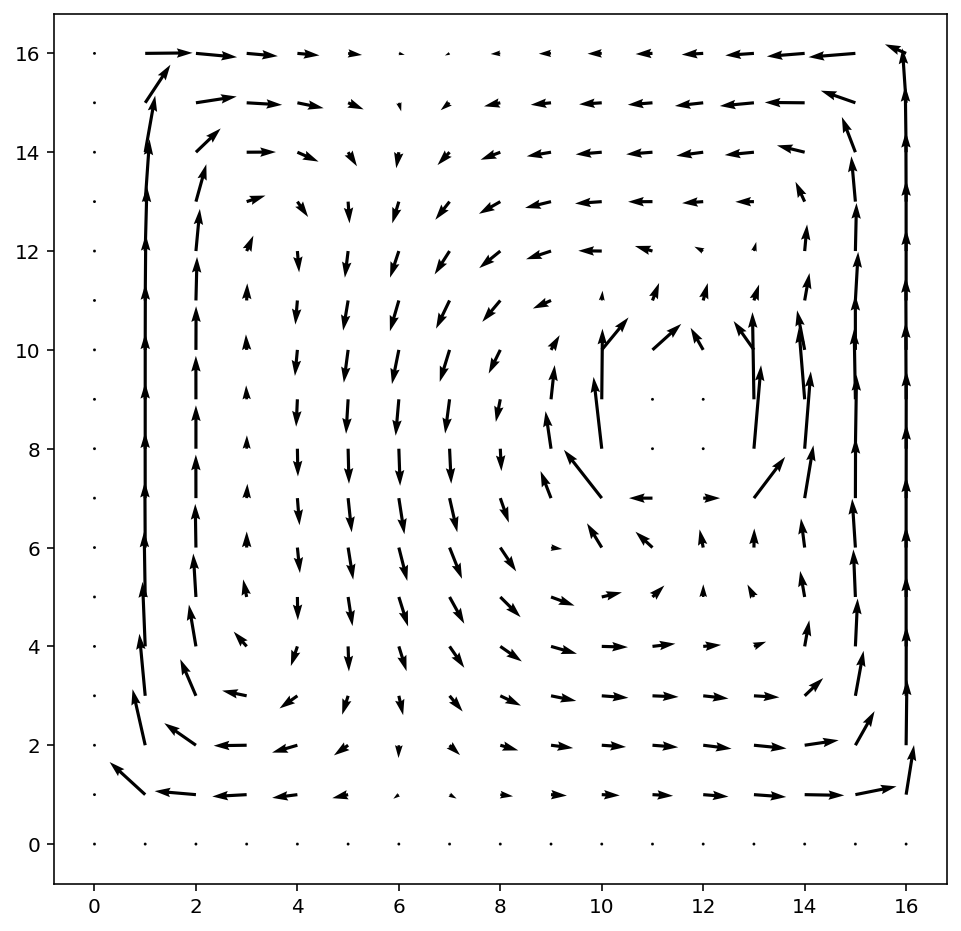

In [490]:
plt.figure(figsize=(8,8))
plt.quiver(uF[::3, ::3], vF[::3, ::3])

--- 

## Problem 11

Create a different bathymetry (your choice) and explore the lake's circulation for a variety of wind directions (at least two).  Submit you solution as a `.ipynb` notebook. There is no need to submit the Fortran code or the data but your notebook should contain sufficient details on what is being simulated and visualizations of your results.

Please consider OMB 5.5.8 to ensure you are running your model at a reasonable resolution and time steps given what is available on your computer.  

---

## OMB 5.6 Movement of Tracers

### OMB 5.6.1 Lagrangian Versus Eulerian Tracers

Lagrangian tracers are non-buoyant fluid parcels that move passively with the flow.
In practice, the trajectory of Lagrangian floats are predicted by means of displacement distances per time step derived from the velocity at float locations. Eulerian
tracers, on the other hand, are concentration fields being subject to advection and
mixing by currents.

--- 

## Problem 12

Read carefully OMB 5.6 on the Movement of Tracers and complete (in Python) OMB 5.7 Exercise 11: Eulerian Advection  as a Jupyter notebook.  While the Fortran and Scilab code provided by the textbook author ("Exercise 11") may serve as useful reference, you are expected to implement your own solution to this problem.

Your solution should include an comparison of different *Total Variation Diminishing* (TVD) schemes:
- upstream scheme
- Lax-Wendroff scheme
- Superbee scheme
- Super-C scheme

Use the same output file `src/OMB/Ex10/output.nc` to drive the advection under the assumption of *frozen dynamics*. That is, use the velocity field from the last time step of the Exercise 10 simulation to drive the Eulerian advection.  Do you agree with the same recommendations that are given in the textbook in OMB 5.7.4? Explain.

---

## OMB 5.8 Exercise 12: Lagrangian Trajectories

### 5.8.1 Aim

The aim of this exercise is to predict the pathways of individual non-buoyant
Lagrangian floats subject to the lake’s steady-state circulation circulation.

### 5.8.2 Task Description

Using the steady-state flow field predicted in Exercise 10, a large number (3000)
of Lagrangian floats is introduced at random locations in the lake to predict their
pathways over a day. The horizontal displacement of a float is calculated from:

$$\begin{align}
X^{n+1}_m &= X^n_m + \Delta t U_m^n \\
Y^{n+1}_m &= Y^n_m + \Delta t V_m^n \\
\end{align}$$

where $m$ is the float number, $X$ and $Y$ specifies the location of a float, and $U$ and
$V$ is the ambient lateral flow interpolated to the float location. To make this task
easier, instead of interpolating velocity to the precise location of a float, we use the
velocity interpolated to the nearest “h” grid point as a proxy. Zones within a distance
of 500 m from the lake’s banks are initially kept free of floats to avoid that floats
become trapped in zones of little or zero flow.

### 5.8.3 Results

In [1]:
filename = 'src/OMB_Ex10/output.nc' # CHANGE PATH AS NEEDED

In [260]:
ds = xr.open_dataset(filename)
ds

<xarray.Dataset>
Dimensions:  (time: 121, xh: 53, xu: 53, xv: 53, yh: 53, yu: 53, yv: 53)
Coordinates:
  * time     (time) datetime64[ns] 2000-01-01 2000-01-01T02:00:00 ... 2000-01-11
  * xh       (xh) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * yh       (yh) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * xu       (xu) float32 75.0 175.0 275.0 ... 5.075e+03 5.175e+03 5.275e+03
  * yu       (yu) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * xv       (xv) float32 25.0 125.0 225.0 ... 5.025e+03 5.125e+03 5.225e+03
  * yv       (yv) float32 75.0 175.0 275.0 ... 5.075e+03 5.175e+03 5.275e+03
Data variables:
    h        (time, xh, yh) float32 ...
    eta      (time, xh, yh) float32 ...
    u        (time, xu, yu) float32 ...
    v        (time, xv, yv) float32 ...

In [476]:
ntra = 3000 # number of floats
nx = 51
ny = 51
dx = 100
dy = 100
time = 0

# initial random locations of tracers
xlen = nx*dx - 10*dx
ylen = ny*dy - 10*dy

tra_x = 5*dx + np.random.rand(ntra)*xlen
tra_y = 5*dy + np.random.rand(ntra)*ylen

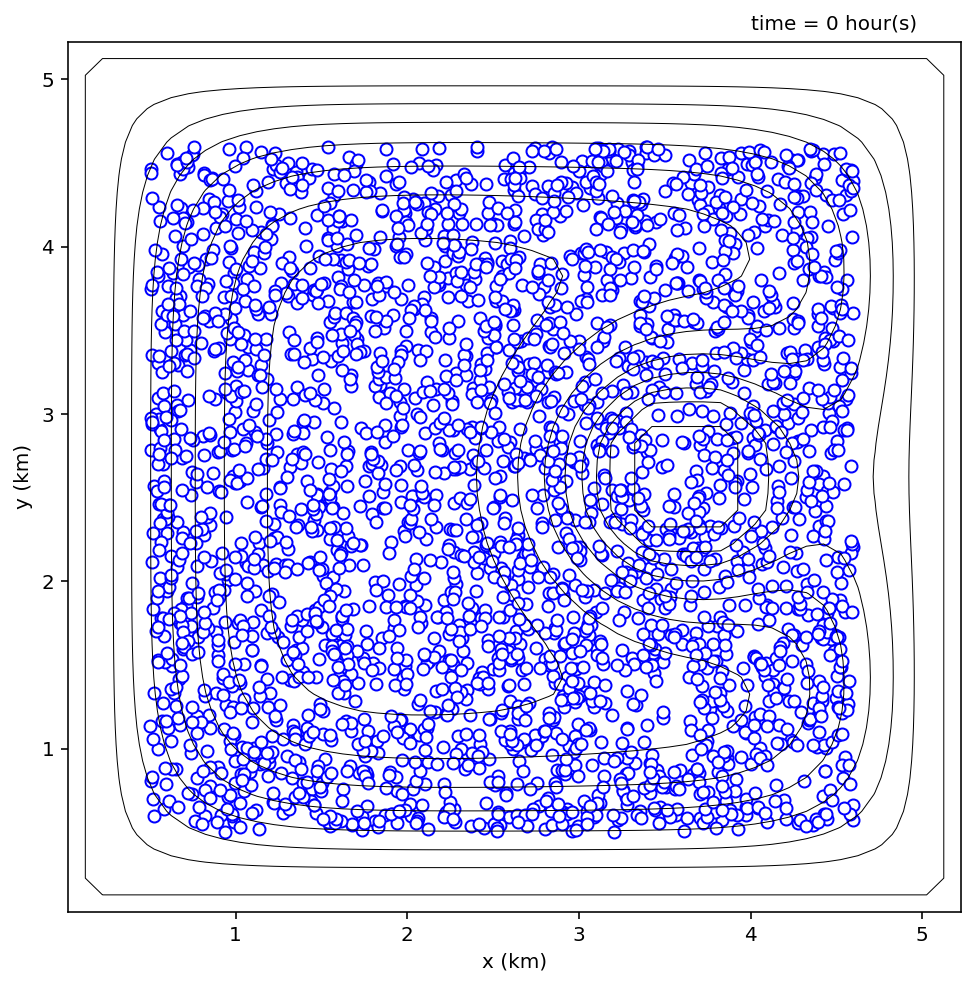

In [477]:
def plot_tracers(tra_x, tra_y, time=0, ax=None):
    if ax is None:
        fig, ax = plt.subplots(figsize=(8,8))

    ax.contour(ds.xh/1e3, ds.yh/1e3, ds.h[0].T, colors='k', linewidths=0.5)
    ax.scatter(tra_x/1e3, tra_y/1e3, color='w', edgecolor='b')
    ax.set_xlabel('x (km)')
    ax.set_ylabel('y (km)')
    ax.text(4, 5.3, f'time = {time/3600:.0f} hour(s)')
    
plot_tracers(tra_x, tra_y)

In [478]:
# extract the velocity from the previous exercise
u = ds.u[120].values
v = ds.v[120].values

In [479]:
tra_x = 5*dx + np.random.rand(ntra)*xlen
tra_y = 5*dy + np.random.rand(ntra)*ylen

dt = 10

# runtime parameters
ntot = int(12*3600/dt)

# output parameter, every 5 minutes
nout = int(5*60/dt)

results = []
#---------------------------
# simulation loop
#---------------------------
for n in range(ntot):

    time = n*dt

    # locate grid cell of tracer
    kpos = (np.trunc((tra_x + 0.5 * dx) / dx) + 1).astype(int)
    jpos = (np.trunc((tra_y + 0.5 * dy) / dy) + 1).astype(int)

    # velocity interpolated to nearest h gridpoint
    uu = 0.5*(u[kpos-1, jpos]+u[kpos,jpos])
    vv = 0.5*(v[kpos, jpos-1]+v[kpos,jpos])

    # change of location
    tra_x = tra_x + dt*uu
    tra_y = tra_y + dt*vv
    
    if (n % nout == 0):
       
        results.append((tra_x, tra_y, time))

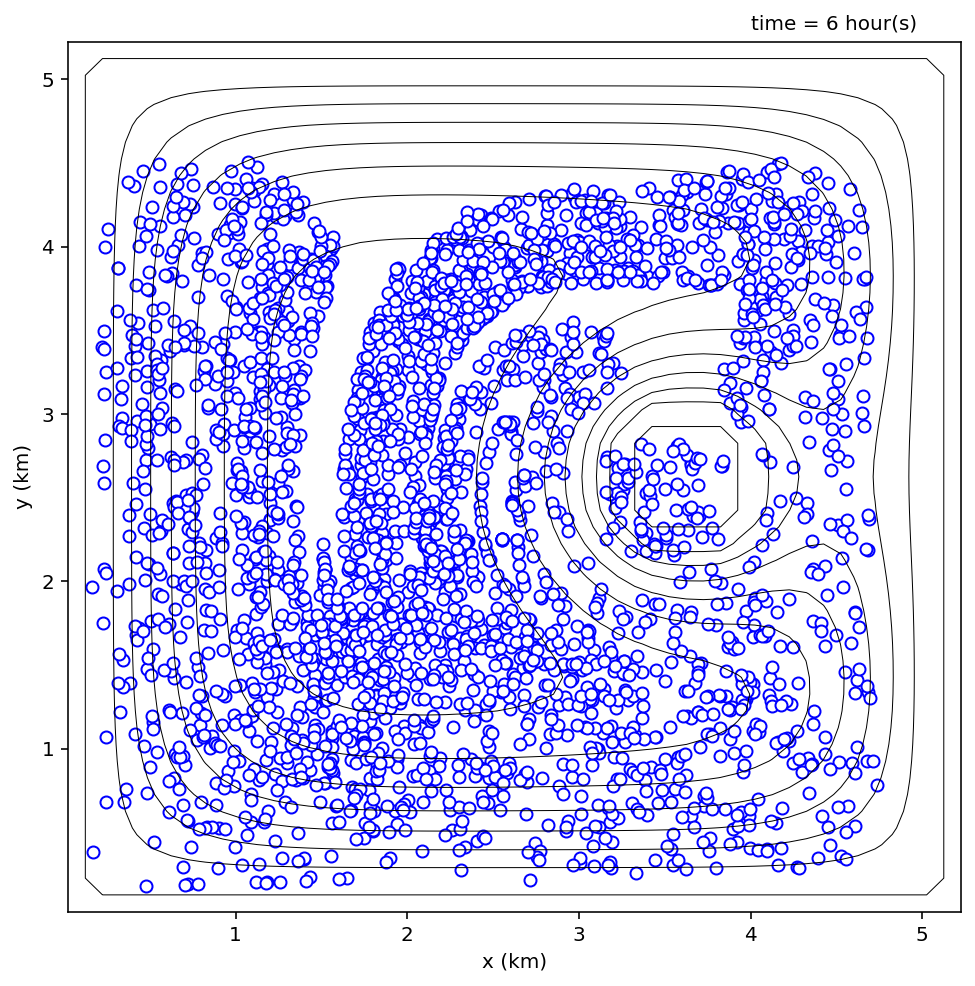

In [480]:
tra_x, tra_y, time = results[72]
plot_tracers(tra_x, tra_y, time)

In [448]:
def animate_tracers(results):
    fig, ax = plt.subplots(figsize=(8,8))

    tracers, =  ax.plot([], [], 'o', color='w', mec='b')
    text = ax.text(4, 5.3, f'time= {t[0]:.0f} days')

    def init():
        ax.contour(ds.xh/1e3, ds.yh/1e3, ds.h[0].T, colors='k', linewidths=0.5)
        ax.set_title('Lagrangian Tracers')
        ax.set_xlabel('x (km)')
        ax.set_ylabel('y (km)')
        
        return tracers, text
    
    def update(frame):
        tra_x, tra_y, time = results[frame]

        tracers.set_data(tra_x/1e3, tra_y/1e3)
        
        text.set_text(f'time= {time/3600:.1f} hour(s)')
        
        return tracers, text
    
        
    anim = FuncAnimation(fig, update, blit=True,
                         init_func=init,
                         frames=len(results),
                         )
    plt.close(fig)
    
    return anim
    
animate_tracers(results)

In [454]:
times = np.array([t[2] for t in results])
trajectories = np.array([ [t[0], t[1]] for t in results])


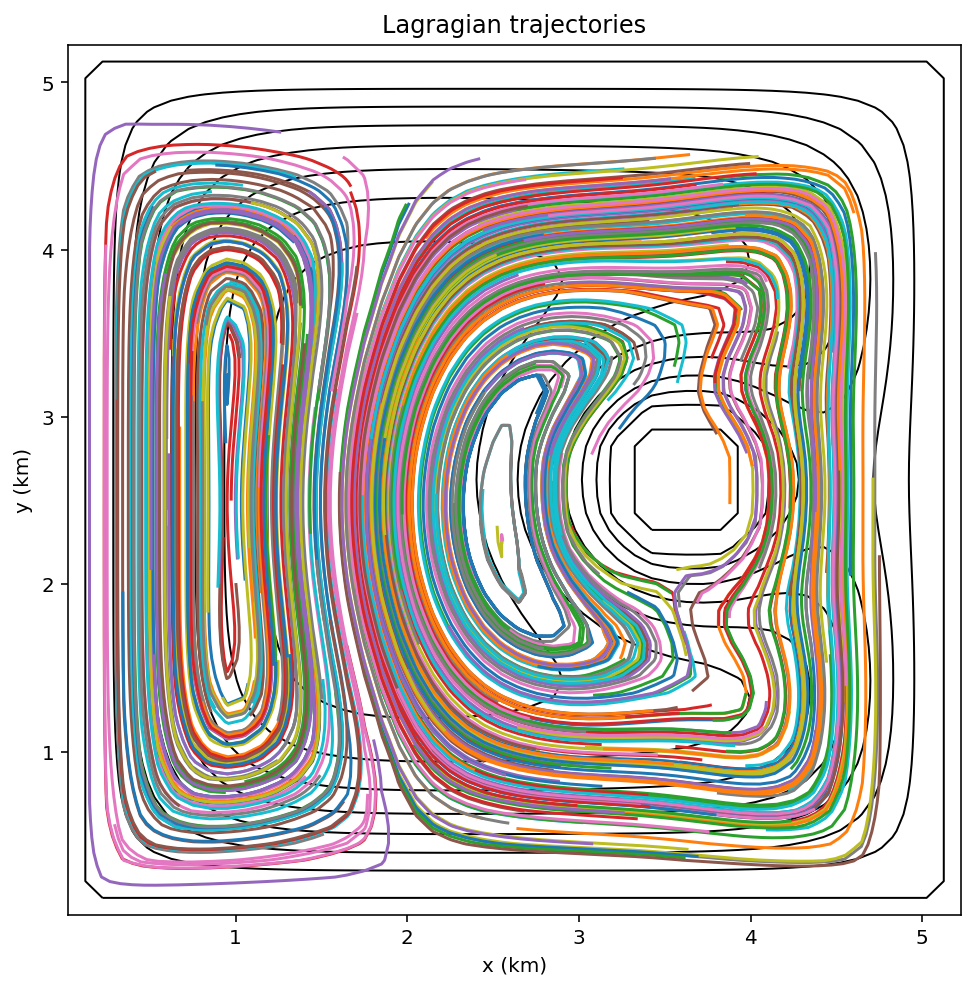

In [481]:
fig, ax = plt.subplots(figsize=(8,8))

ax.contour(ds.xh/1e3, ds.yh/1e3, ds.h[0].T, colors='k', linewidths=1)
    
p = 250 # number of trajectories to plot
for i in range(p):
    ax.plot(trajectories[:, 0, i*(ntra//p)]/1e3, trajectories[:, 1, i*(ntra//p)]/1e3)
    
ax.set_xlabel('x (km)')
ax.set_ylabel('y (km)')
ax.set_title('Lagragian trajectories')
plt.show()